| Package        | Version                       |
|----------------|-------------------------------|
| scipy          | 1.15.3                        |
| scanpy         | 1.11.1                        |
| gseapy         | 1.1.3                         |
| plotnine       | 0.14.5                        |
| decoupler      | 1.9.2                         |
| harmonypy      | 0.0.10                        |
| igraph         | 0.11.8                        |
| bbknn          | 1.6.0                         |
| pygraphviz     | 1.14                          |
| cnmf           | 1.7.0                         |
| scikit-misc    | 0.5.1                         |
| palantir       | 1.4.0                         |

In [3]:
import scanpy.external as sce
from matplotlib import rcParams
import gseapy as gp
import matplotlib.pyplot as plt
import os
import scanpy as sc
from matplotlib.pyplot import rc_context
import numpy as np
import matplotlib as mpl
import decoupler as dc
import pandas as pd

%matplotlib inline
from scipy.io import mmread
import scipy.sparse as sp
from IPython.display import Image
from cnmf import cNMF, Preprocess
import seaborn as sns
np.random.seed(550)

In [ ]:
adata_combined = sc.read('/content/drive/MyDrive/sc.h5ad')
print(adata_combined.X)

  (625, 0)	1.0
  (768, 0)	1.0
  (937, 0)	1.0
  (2118, 0)	1.0
  (2425, 0)	1.0
  (2841, 0)	1.0
  (3956, 0)	1.0
  (4598, 0)	1.0
  (5761, 0)	1.0
  (5942, 0)	1.0
  (6169, 0)	1.0
  (6410, 0)	1.0
  (6511, 0)	1.0
  (6789, 0)	1.0
  (7200, 0)	1.0
  (7408, 0)	1.0
  (8182, 0)	1.0
  (8295, 0)	1.0
  (8341, 0)	1.0
  (9326, 0)	1.0
  (9910, 0)	1.0
  (10454, 0)	1.0
  (11975, 0)	1.0
  (12416, 0)	1.0
  (12609, 0)	1.0
  :	:
  (47597, 31289)	1.0
  (48114, 31290)	1.0
  (47120, 31291)	1.0
  (47398, 31292)	1.0
  (47933, 31293)	1.0
  (47120, 31294)	1.0
  (50567, 31294)	1.0
  (46086, 31295)	1.0
  (46640, 31296)	1.0
  (46954, 31297)	1.0
  (45811, 31299)	1.0
  (46067, 31301)	1.0
  (50659, 31302)	1.0
  (45379, 31303)	1.0
  (49939, 31304)	1.0
  (48426, 31305)	1.0
  (45523, 31306)	1.0
  (45868, 31306)	1.0
  (49124, 31306)	1.0
  (45367, 31307)	1.0
  (46770, 31308)	1.0
  (48505, 31309)	1.0
  (46985, 31310)	1.0
  (45947, 31311)	1.0
  (47960, 31312)	1.0


In [ ]:
adata_combined

AnnData object with n_obs × n_vars = 50841 × 31313
    obs: 'orig.ident', 'celltype', 'class', 'ident'
    uns: 'X_name'

In [ ]:
adata_combined.obs_names

Index(['JA-1_AAACCCACACCTCAGG-1', 'JA-1_AAACCCACAGGCAATG-1',
       'JA-1_AAACCCAGTATCGCGC-1', 'JA-1_AAACCCAGTTCGGCCA-1',
       'JA-1_AAACCCATCTCTAGGA-1', 'JA-1_AAACCCATCTGTAACG-1',
       'JA-1_AAACGCTAGAAGATCT-1', 'JA-1_AAACGCTAGAGGATGA-1',
       'JA-1_AAACGCTCAACACAGG-1', 'JA-1_AAACGCTCAACCAGAG-1',
       ...
       'PCT-3_TTTGGTTCACGAGGTA-1', 'PCT-3_TTTGGTTTCATTGTTC-1',
       'PCT-3_TTTGTTGAGCAAGCCA-1', 'PCT-3_TTTGTTGAGGTACAGC-1',
       'PCT-3_TTTGTTGGTAAGCTCT-1', 'PCT-3_TTTGTTGGTACAGCGA-1',
       'PCT-3_TTTGTTGGTGTGACCC-1', 'PCT-3_TTTGTTGGTTCAGTAC-1',
       'PCT-3_TTTGTTGTCCTAGCTC-1', 'PCT-3_TTTGTTGTCGCAGTGC-1'],
      dtype='object', length=50841)

In [ ]:
adata_combined.var_names

Index(['AL627309.1', 'AL627309.5', 'AL627309.4', 'AP006222.2', 'AL732372.1',
       'LINC01409', 'FAM87B', 'LINC01128', 'LINC00115', 'FAM41C',
       ...
       'LINC01640', 'AL023553.1', 'GLRA2', 'PHEX-AS1', 'AC092832.2', 'PPP1R2C',
       'LINC00269', 'CDX4', 'ATP1B4', 'HSFX1'],
      dtype='object', length=31313)

normalizing counts per cell
    finished (0:00:01)


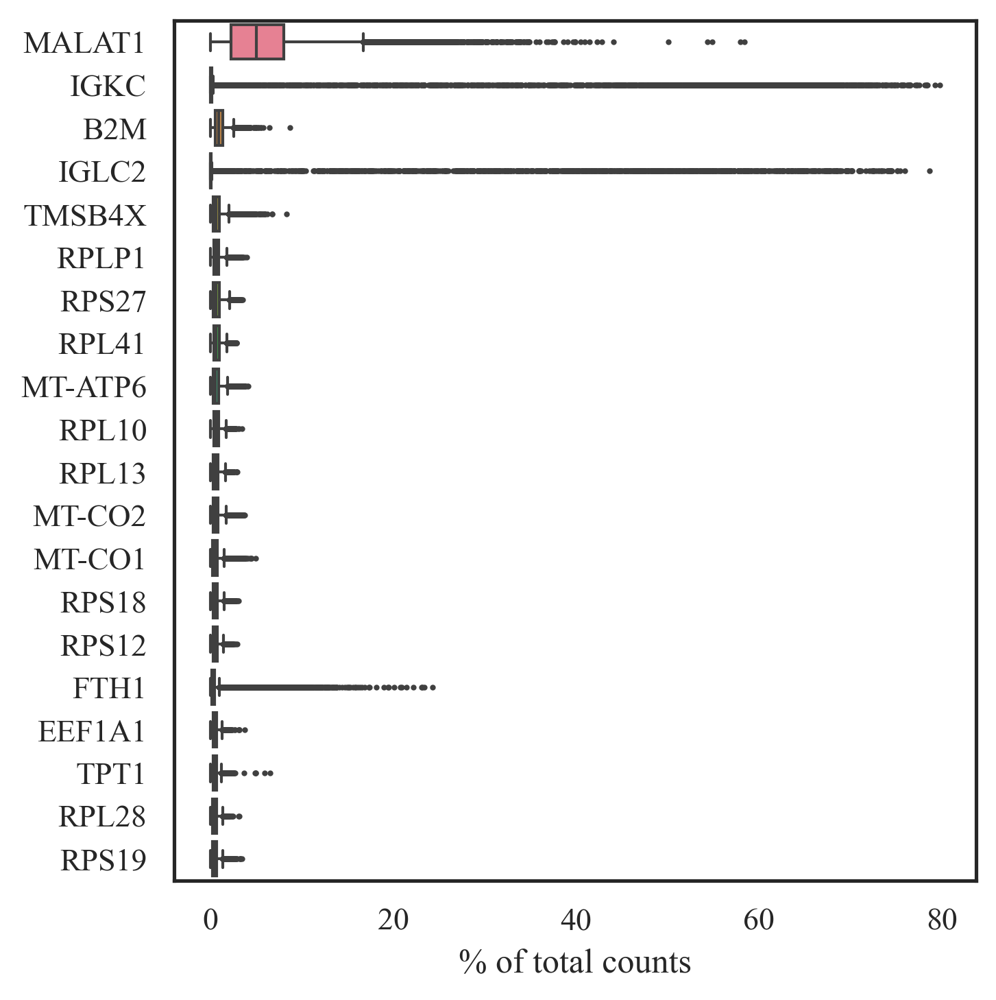

In [ ]:
sc.pl.highest_expr_genes(adata_combined, n_top=20)

In [ ]:
sc.pp.filter_cells(adata_combined, min_genes=500)
sc.pp.filter_cells(adata_combined, max_genes=6000)
sc.pp.filter_genes(adata_combined, min_cells=3)

filtered out 4092 cells that have less than 500 genes expressed
filtered out 1188 cells that have more than 6000 genes expressed
filtered out 3608 genes that are detected in less than 3 cells


In [ ]:
adata_combined.var["mt"] = adata_combined.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(
    adata_combined, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

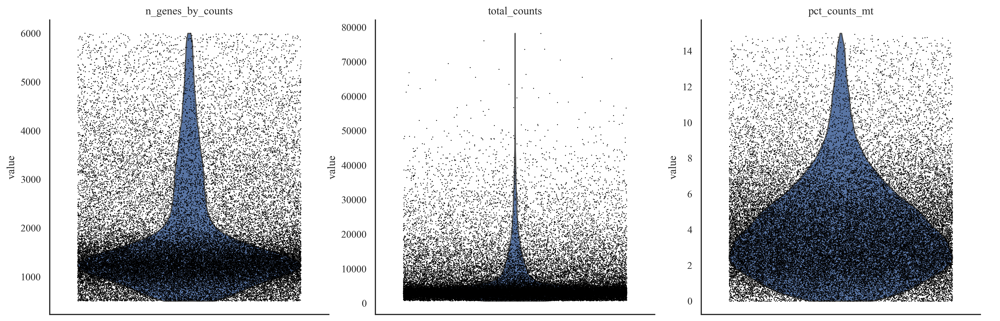

In [ ]:
sc.pl.violin(
    adata_combined,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

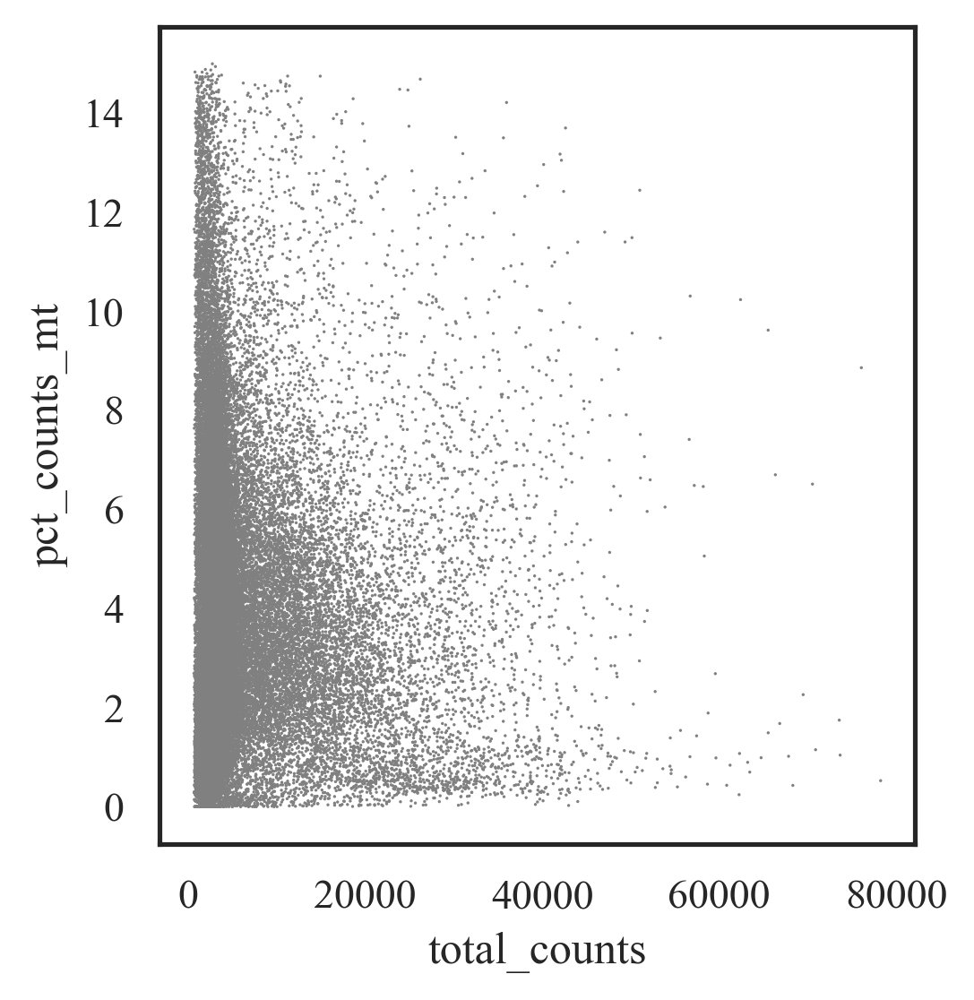

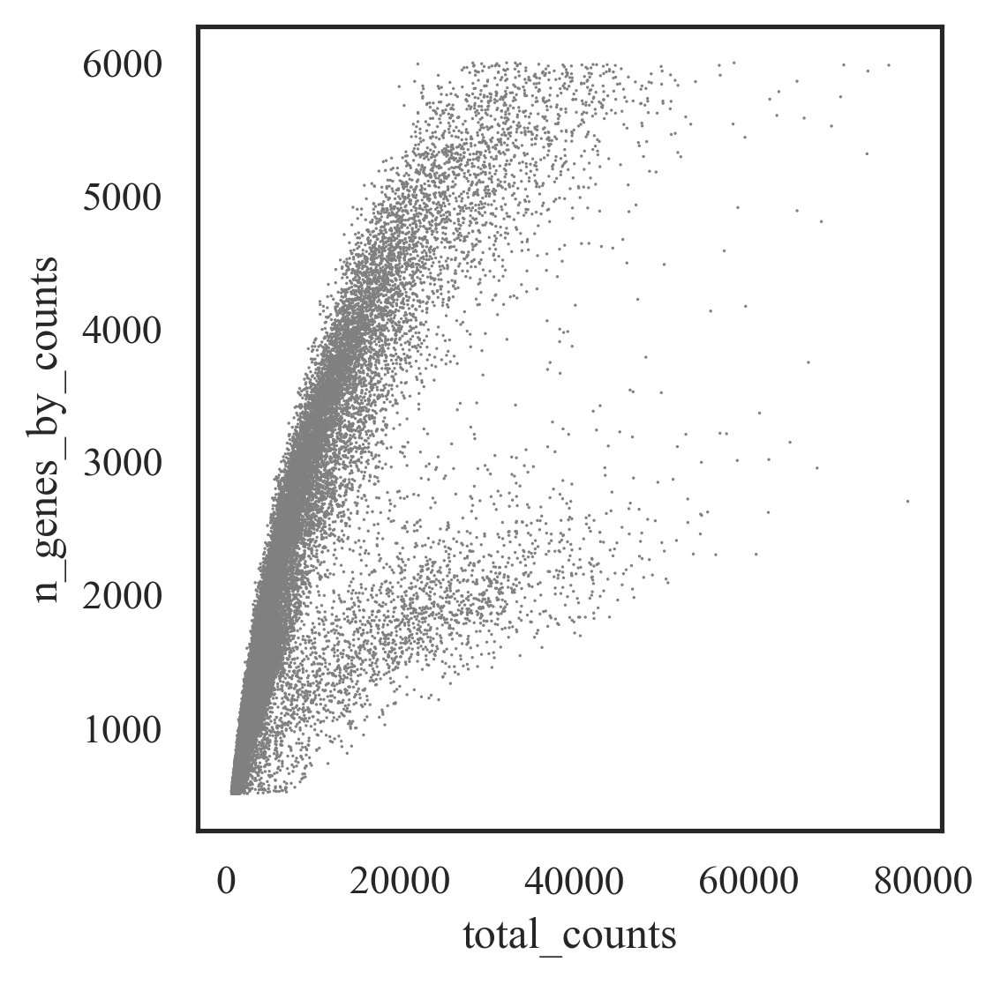

In [ ]:
sc.pl.scatter(adata_combined, x="total_counts", y="pct_counts_mt")
sc.pl.scatter(adata_combined, x="total_counts", y="n_genes_by_counts")

In [ ]:
adata_combined = adata_combined[(adata_combined.obs['total_counts'] > 1000), :]
adata_combined = adata_combined[adata_combined.obs['pct_counts_mt'] < 15, :]
adata = adata_combined
print(adata)

View of AnnData object with n_obs × n_vars = 44681 × 27705
    obs: 'orig.ident', 'celltype', 'class', 'ident', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'X_name', 'orig.ident_colors'


In [ ]:
print(adata)

View of AnnData object with n_obs × n_vars = 44681 × 27705
    obs: 'orig.ident', 'celltype', 'class', 'ident', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'X_name', 'orig.ident_colors'


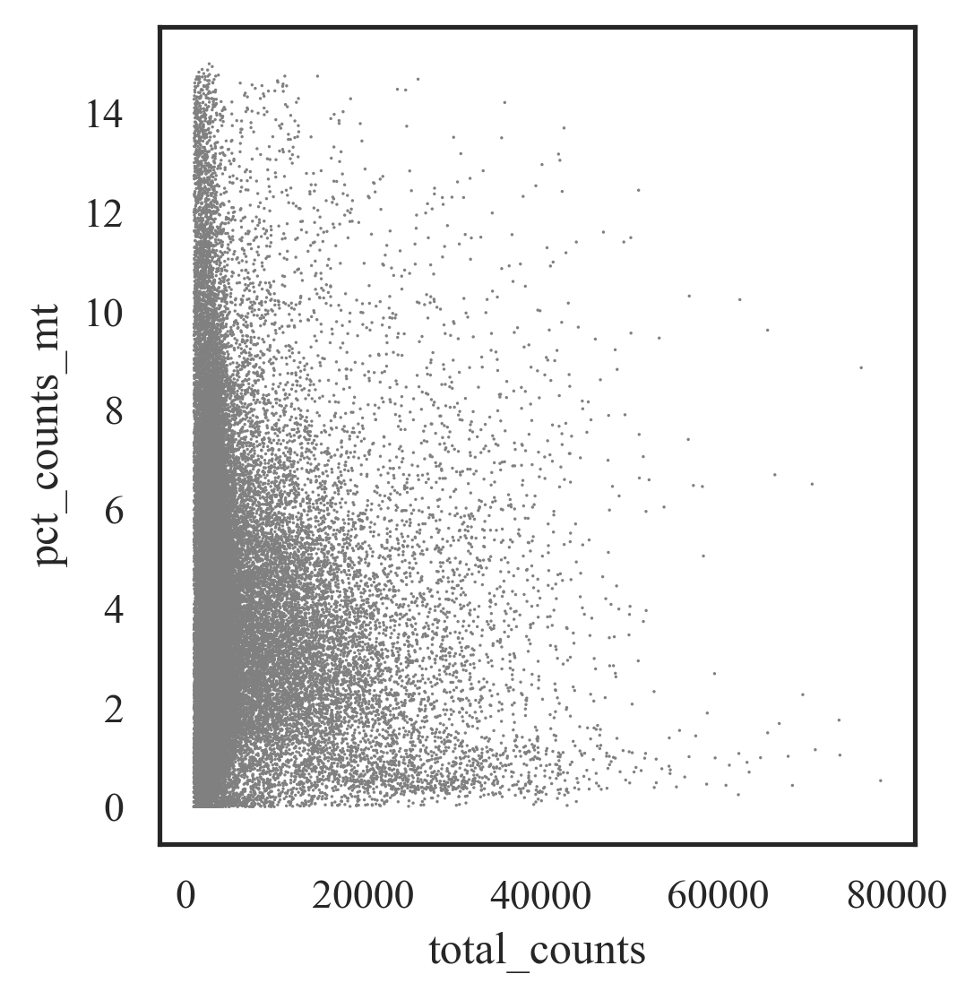

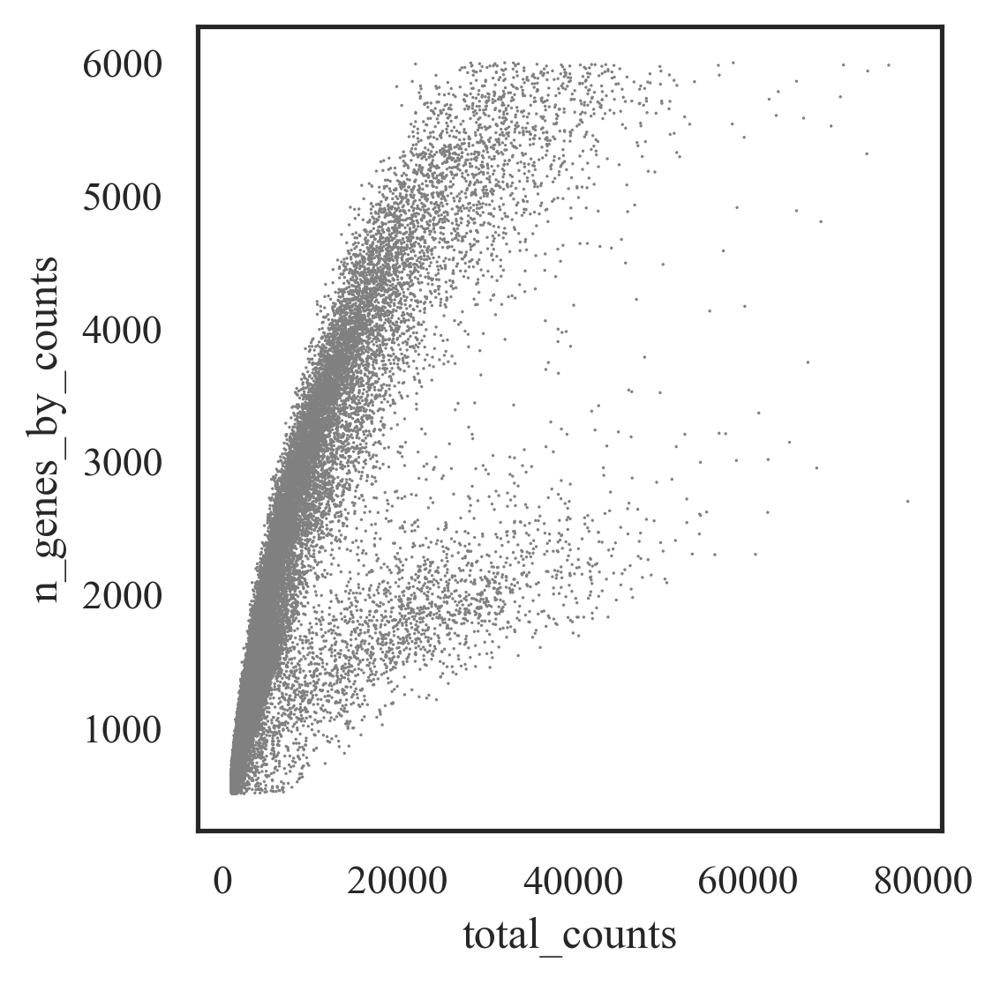

In [ ]:
sc.pl.scatter(adata, x="total_counts", y="pct_counts_mt")
sc.pl.scatter(adata, x="total_counts", y="n_genes_by_counts")

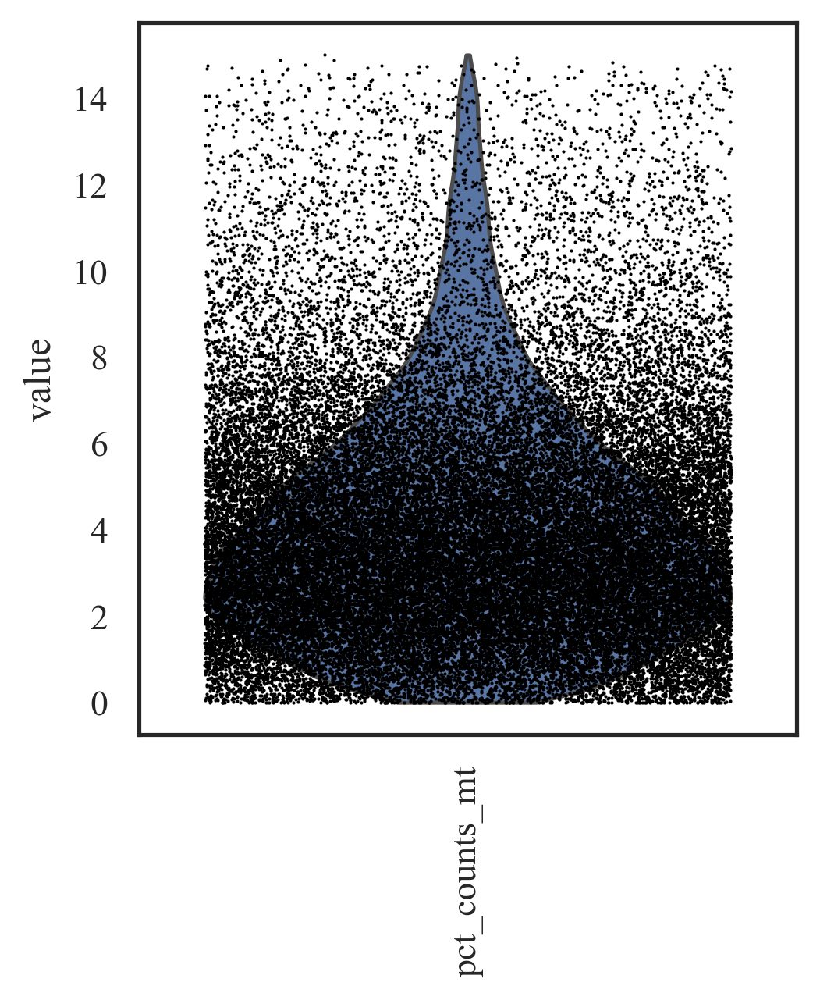

In [ ]:
sc.pl.violin(
    adata,
    keys=["pct_counts_mt"],
    jitter=0.4,
    rotation=90
)

/usr/local/lib/python3.11/dist-packages/scanpy/preprocessing/_normalization.py:208: UserWarning: Received a view of an AnnData. Making a copy.


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['pct_counts_mt']


/usr/local/lib/python3.11/dist-packages/scanpy/preprocessing/_simple.py:709: UserWarning: Received a view of an AnnData. Making a copy.


    sparse input is densified and may lead to high memory use


/usr/local/lib/python3.11/dist-packages/scanpy/preprocessing/_simple.py:647: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (Array(float64, 1, 'A', False, aligned=True), Array(float64, 2, 'C', False, aligned=True))
/usr/local/lib/python3.11/dist-packages/scanpy/preprocessing/_simple.py:647: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (Array(float64, 1, 'A', False, aligned=True), Array(float64, 2, 'C', False, aligned=True))


    finished (0:00:02)
computing PCA
    with n_comps=50
    finished (0:00:11)


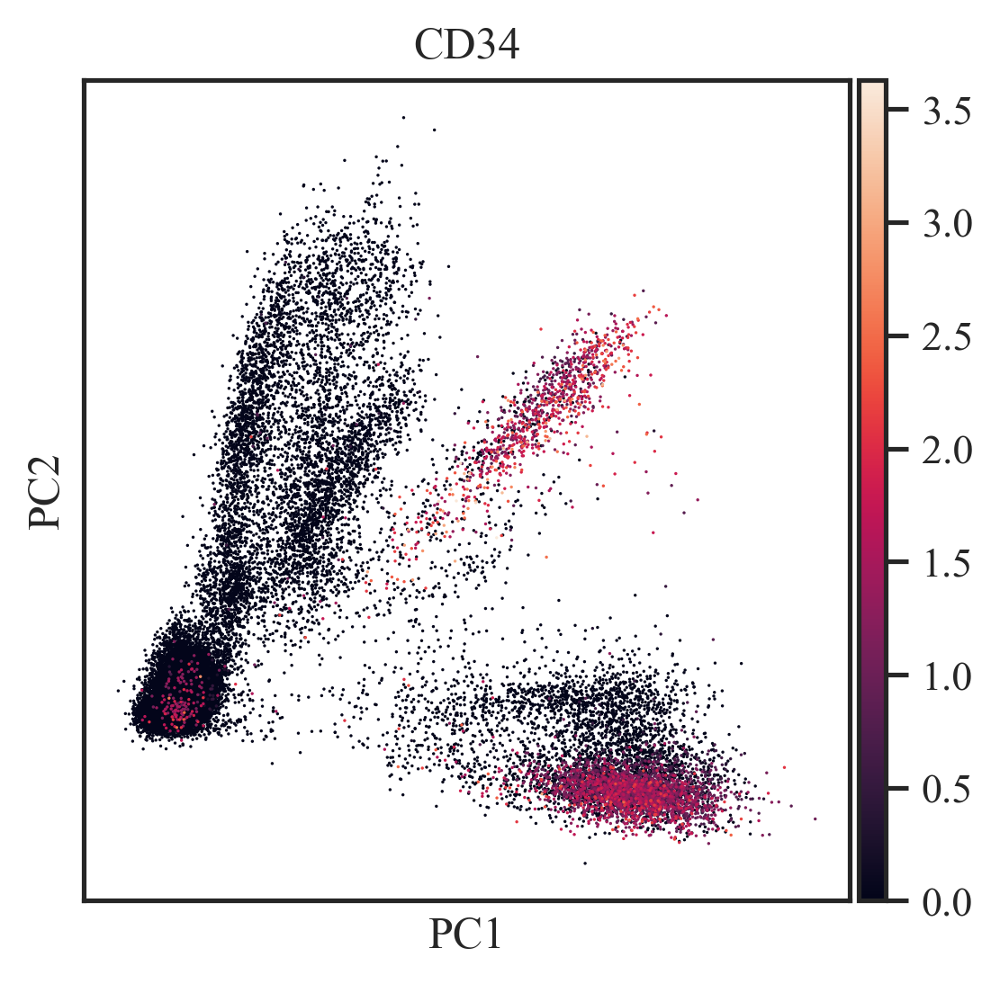

In [ ]:
adatacount = adata.copy()

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5, batch_key="orig.ident")

adata.raw = adata
adata = adata[:, adata.var.highly_variable]

sc.pp.regress_out(adata, ['pct_counts_mt'])
sc.pp.scale(adata, max_value=10)

sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca(adata, color='CD34')

In [ ]:
adata

AnnData object with n_obs × n_vars = 44681 × 3106
    obs: 'orig.ident', 'celltype', 'class', 'ident', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'X_name', 'orig.ident_colors', 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

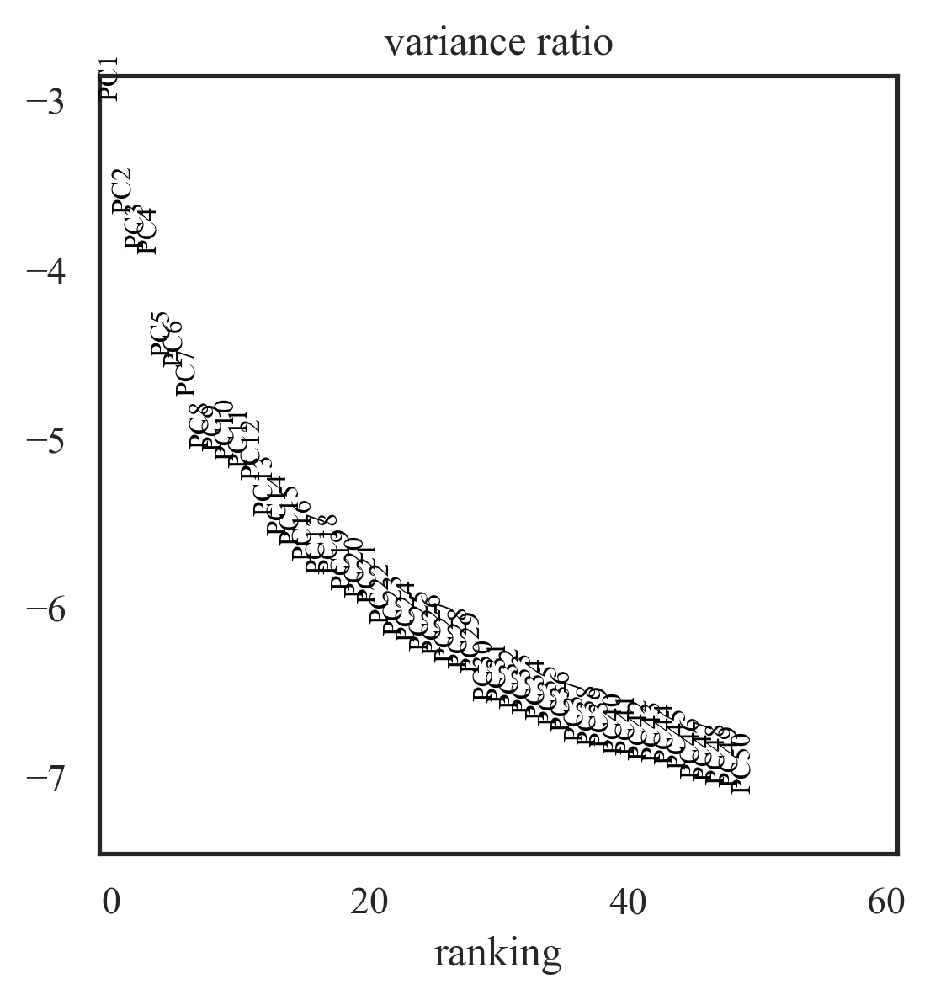

In [ ]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=60)

## integration

In [ ]:
def integrate_and_cluster(adata, method='harmony',n_pcs=30):
    if method.lower() == 'harmony':
        print(">> Using Harmony for batch integration...")
        sce.pp.harmony_integrate(adata, 'orig.ident')
        sc.pp.neighbors(adata, n_pcs=n_pcs, use_rep='X_pca_harmony')
    elif method.lower() == 'bbknn':
        print(">> Using BBKNN for batch integration...")
        import bbknn
        sc.external.pp.bbknn(
            adata,
            batch_key='orig.ident',
            neighbors_within_batch=15,
            n_pcs=n_pcs
        )
    else:
        print(">> No batch integration (using standard neighbors)...")
        sc.pp.neighbors(adata, n_pcs=n_pcs, use_rep='X_pca')
    sc.tl.umap(adata)


    return adata

method = "harmony"
adata_concat = integrate_and_cluster(adata, method=method, n_pcs=30)

2025-03-12 17:24:27,393 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
INFO:harmonypy:Computing initial centroids with sklearn.KMeans...


>> Using Harmony for batch integration...


2025-03-12 17:24:31,904 - harmonypy - INFO - sklearn.KMeans initialization complete.
INFO:harmonypy:sklearn.KMeans initialization complete.
2025-03-12 17:24:32,141 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2025-03-12 17:24:45,236 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2025-03-12 17:24:58,399 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2025-03-12 17:25:12,698 - harmonypy - INFO - Iteration 4 of 10
INFO:harmonypy:Iteration 4 of 10
2025-03-12 17:25:29,015 - harmonypy - INFO - Iteration 5 of 10
INFO:harmonypy:Iteration 5 of 10
2025-03-12 17:25:43,781 - harmonypy - INFO - Iteration 6 of 10
INFO:harmonypy:Iteration 6 of 10
2025-03-12 17:25:51,537 - harmonypy - INFO - Iteration 7 of 10
INFO:harmonypy:Iteration 7 of 10
2025-03-12 17:25:58,712 - harmonypy - INFO - Iteration 8 of 10
INFO:harmonypy:Iteration 8 of 10
2025-03-12 17:26:03,793 - harmonypy - INFO - Iteration 9 of 10
INFO:harmonypy:Iteration 9 of

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:27)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:30)


In [ ]:
for res in [1.0]:
    sc.tl.leiden(
        adata, key_added=f"leiden_res_ori_{res:4.2f}", resolution=res, flavor="igraph"
    )

running Leiden clustering
    finished: found 24 clusters and added
    'leiden_res_ori_1.00', the cluster labels (adata.obs, categorical) (0:00:01)


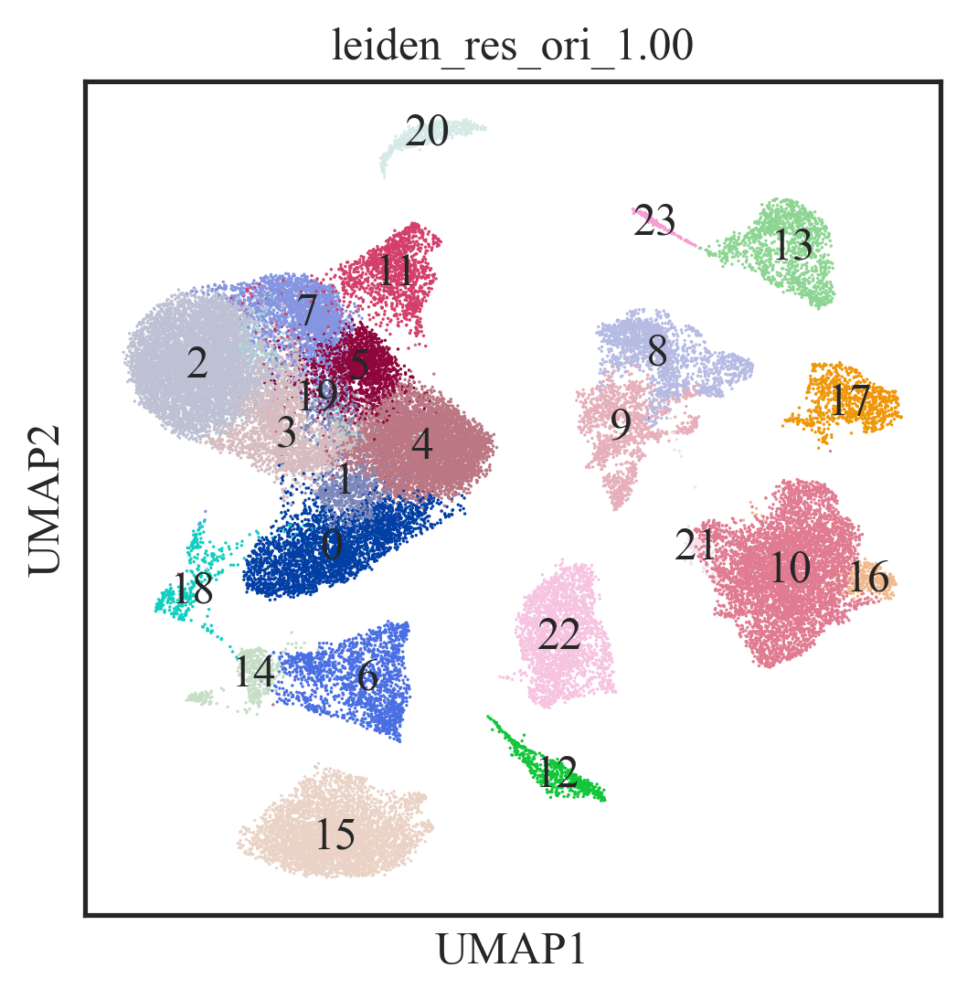

In [ ]:
sc.pl.umap(
    adata,
    color=["leiden_res_ori_1.00"],
    legend_loc="on data",
)

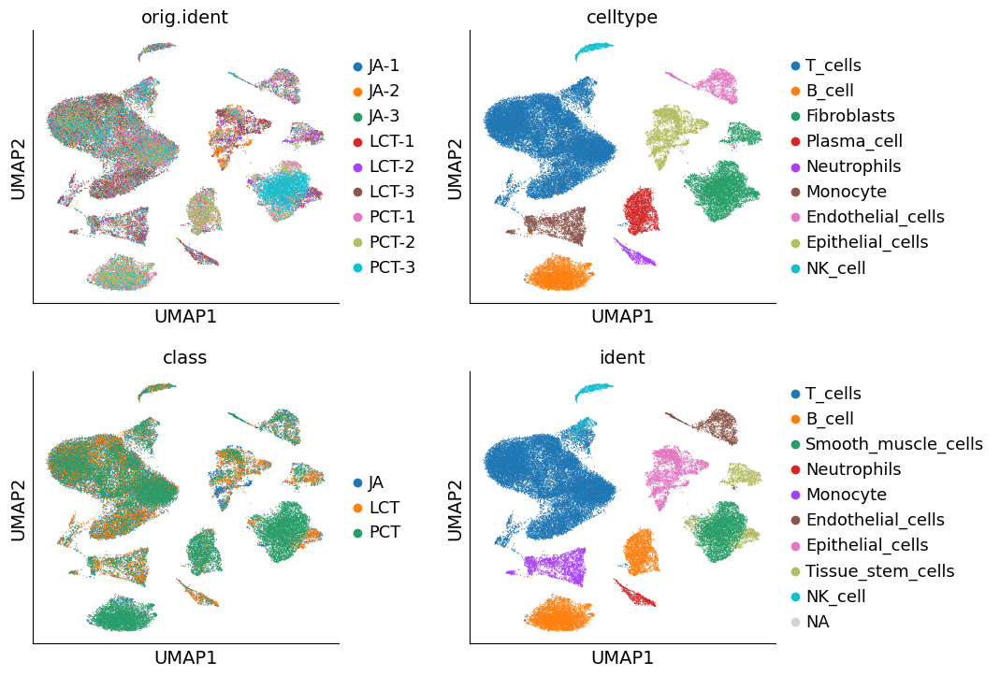

In [ ]:
import scanpy as sc
import matplotlib.pyplot as plt
sc.pl.umap(adata, color=['orig.ident', 'celltype', 'class', 'ident'], wspace=0.3,ncols=2)

In [ ]:
sc.tl.rank_genes_groups(adata, groupby="leiden_res_ori_1.00", method="wilcoxon")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:02:23)


/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:440: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1

In [ ]:
sc.tl.rank_genes_groups(adata, groupby="leiden_res_ori_1.00", method="wilcoxon")

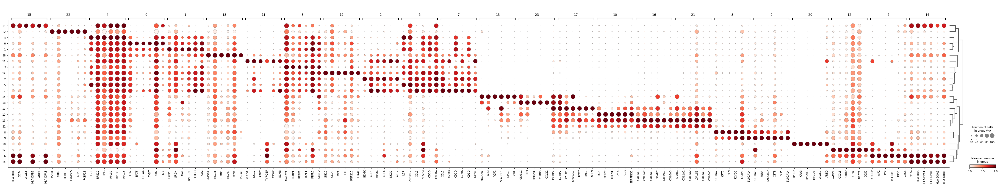

In [ ]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden_res_ori_1.00", standard_scale="var", n_genes=6
)

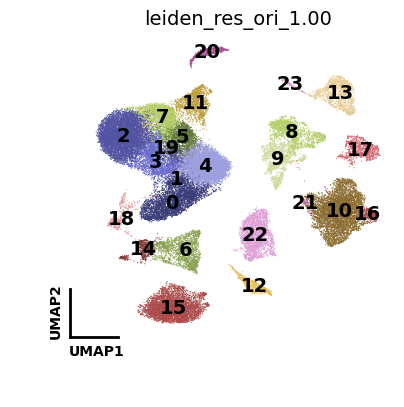

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res_ori_1.00']`
categories: 0, 1, 2, etc.
var_group_labels: stromal, immune, epithelial


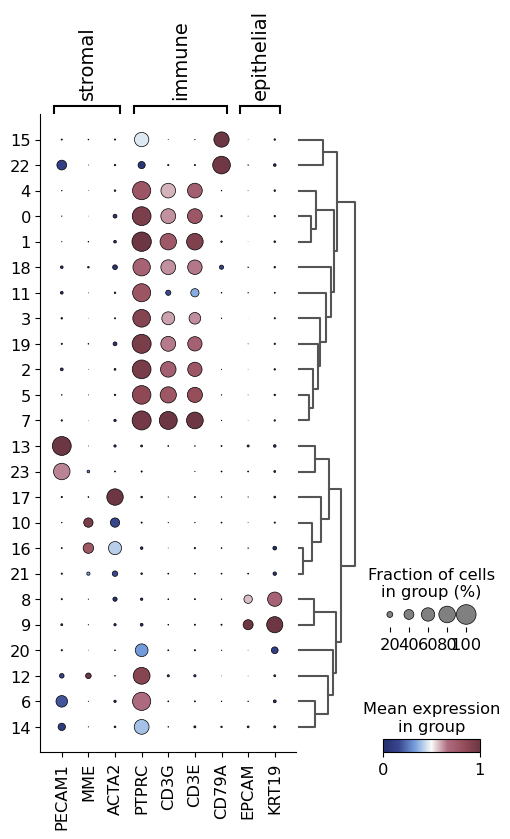

categories: 0, 1, 2, etc.
var_group_labels: Plasma cell, T, CD8+T, etc.


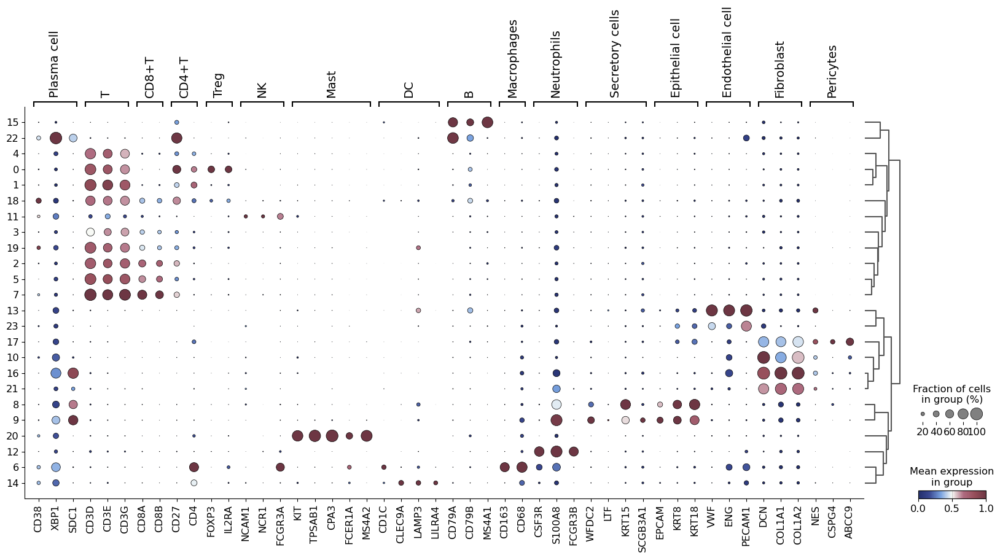

In [ ]:
marker_genes_major3 = {
    "stromal": ['PECAM1','MME','ACTA2'],
    "immune": ["PTPRC","CD3G","CD3E","CD79A"],
    "epithelial": ["EPCAM",'KRT19']
    }

marker_genes_dict = {
    "Plasma cell": ["CD38", "XBP1", "SDC1"],
    "T": ["CD3D", "CD3E", "CD3G"],
    "CD8+T": ["CD8A", "CD8B"],
    #"Cycling": ["STMN1", "TUBA1B", "MKI67", "TYMS"],
    "CD4+T": ["CD27", "CD4"],
    "Treg": ["FOXP3", "IL2RA"],
    "NK": ["NCAM1","NCR1", "FCGR3A"],
    "Mast": ["KIT", "TPSAB1", "CPA3", "FCER1A", "MS4A2"],
    "DC": ["CD1C", "CLEC9A", "LAMP3","LILRA4"],
    "B": ["CD79A", "CD79B", "MS4A1"],
    "Macrophages": ["CD163", "CD68"],
    "Neutrophils":["CSF3R","S100A8","FCGR3B"],
    "Secretory cells":["WFDC2","LTF","KRT15","SCGB3A1"], #https://mp.weixin.qq.com/s/OMqp5_zzGV9HzVQbd_AEJA
    "Epithelial cell": ["EPCAM", "KRT8", "KRT18"],
    "Endothelial cell": ["VWF",'ENG', "PECAM1"],
    "Fibroblast": ["DCN","COL1A1", "COL1A2"],
    "Pericytes":["NES", "CSPG4",   # 2-小鼠骨髓白血病 细胞类型&marker基因
                 "ABCC9"]  #间充质细胞的细分亚群情况
    }

ScPyPy.adv_umap(adata, color="leiden_res_ori_1.00", palette='tab20b',min_ax_fontsize = 10,min_ax_lw = 2, save=None,legend_loc="on data")
sc.pl.dotplot(adata, marker_genes_major3, "leiden_res_ori_1.00", dendrogram=True, cmap=custom_cmap, standard_scale = "var" ,edgecolor='black',  # 点的边框颜色
    linewidth=0.5 )

sc.pl.dotplot(adata, marker_genes_dict, "leiden_res_ori_1.00", dendrogram=True, cmap=custom_cmap, standard_scale = "var" ,edgecolor='black',  # 点的边框颜色
    linewidth=0.5 )

In [ ]:
merge_dict = {
    '0': 'CD4$^{+}$T',
    '1': 'CD4$^{+}$T',
    '2': 'CD8$^{+}$T',
    '3': 'CD8$^{+}$T',
    '4': 'CD4$^{+}$T',
    '5': 'CD8$^{+}$T',
    '6': 'Myeloid cells',
    '7': 'CD8$^{+}$T',
    '8': 'Epi',
    '9': 'Epi',
    '10': 'Fibro',
    '11': 'NK cells',
    '12': 'Neutrophils',
    '13': 'Endo',
    '14': 'DC',
    '15': 'B cells',
    '16': 'Fibro',
    '17': 'Pericytes',
    '18': 'CD4$^{+}$T',
    '19': 'CD8$^{+}$T',
    '20': 'Mast cells',
    '21': 'Fibro',
    '22':'Plasma cells',
    '23':"Endo"

}
adata.obs['major2'] = adata.obs['leiden_res_ori_1.00']

marker_genes_dict = {
    "Plasma cell": ["CD38", "XBP1", "SDC1"],
    "NK": ["NCAM1","NCR1", "FCGR3A"],
    "T": ["CD3D", "CD3E", "CD3G"],
    "CD8+T": ["CD8A", "CD8B"],
    "Treg": ["FOXP3", "IL2RA"],
    "Mast": ["KIT", "TPSAB1", "CPA3", "FCER1A", "MS4A2"],
    "DC": ["CD1C", "CLEC9A", "LAMP3","LILRA4"],
    "B": ["CD79A", "CD79B", "MS4A1"],
    "Mono/Macro": ["CD163", "CD68","CD14", "FCGR3A"],
    "Neutrophils":["CSF3R","S100A8","FCGR3B"],
    "Secretory cells":["WFDC2","LTF","SCGB3A1"],
    "Epithelial cell": ["EPCAM", "KRT8", "KRT18"],
    "Endothelial cell": ["VWF",'ENG', "PECAM1"],
    "Fibroblast": ["DCN","COL1A1", "COL1A2"],
    "Pericytes":["NES", "CSPG4","ABCC9"],
    "Macrophages": ["CD68", "CD163"],
    "Monocytes": ["CD14", "CCR2"],



    }

adata.obs['major2'] = adata.obs['major2'].replace(merge_dict)

In [ ]:
new_order = [
    "B cells", "Plasma cells",'NK cells', "CD4$^{+}$T", "CD8$^{+}$T", "Mast cells", "Neutrophils"  , "Myeloid cells",'DC', 'Pericytes' , "Fibro" ,"Endo" ,"Epi"  # Epithelial
]


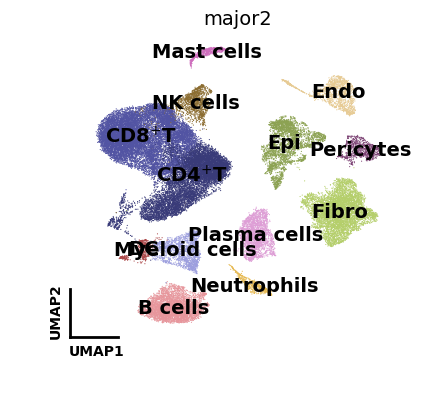

In [ ]:
ScPyPy.adv_umap(adata, color="major2", palette='tab20b',min_ax_fontsize = 10,min_ax_lw = 2, save=None,legend_loc="on data")

In [ ]:
marker_genes_dict = {"B": ["CD79A", "CD79B", "MS4A1"],
        "Plasma": ["CD38", "XBP1", "SDC1"], "NK": ["NCAM1","NCR1", "FCGR3A"], "T": ["CD3D", "CD3E", "CD3G","CD8A", "CD8B"],
  "Treg": ["FOXP3", "IL2RA"],   "Mast": ["KIT", "TPSAB1", "CPA3"] , "Neutrophils":["CSF3R","S100A8","FCGR3B"],"Myeloid": ["CD163", "CD68","CD14", "FCGR3A"],"DC": ["CD1C", "CLEC9A", "LAMP3"],
"Epithelial": ["EPCAM", "KRT8", "KRT18"], "Endothelial": ["VWF",'ENG', "PECAM1"], "Fibroblast": ["DCN","COL1A1", "COL1A2"], "Pericytes":["NES", "CSPG4","ABCC9"],
  }


## Fig1

categories: CD4$^{+}$T, CD8$^{+}$T, Myeloid cells, etc.
var_group_labels: B, Plasma, NK, etc.


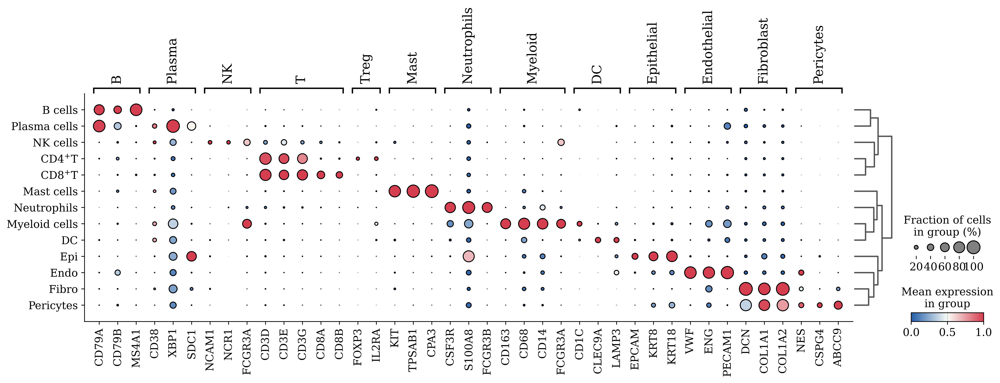

In [ ]:
sc.pl.dotplot(
    adata,
    marker_genes_dict,
    "major2",
    categories_order=new_order,
    dendrogram=True,
    cmap=custom_cmap,
    standard_scale="var",
    #edgecolor='black',
    linewidth=1.0
)


In [ ]:
adata.obs['Samples'] = adata.obs['orig.ident']
adata.obs['Sample_type'] = adata.obs['class']

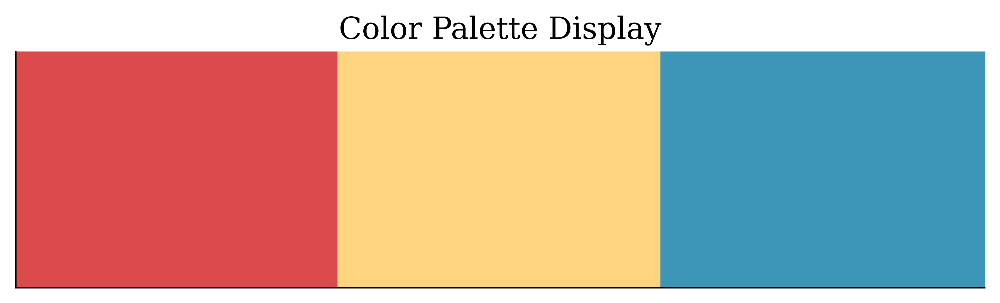

In [ ]:
palette2 = ["#dd4a4c","#fed481",'#3d95b8']
plt.figure(figsize=(8, 2))
for i, color in enumerate(palette2):
    plt.fill_between([i, i+1], 0, 1, color=color)
plt.xlim(0, len(palette2))
plt.ylim(0, 1)
plt.xticks([])
plt.yticks([])
plt.title("Color Palette Display")
plt.show()

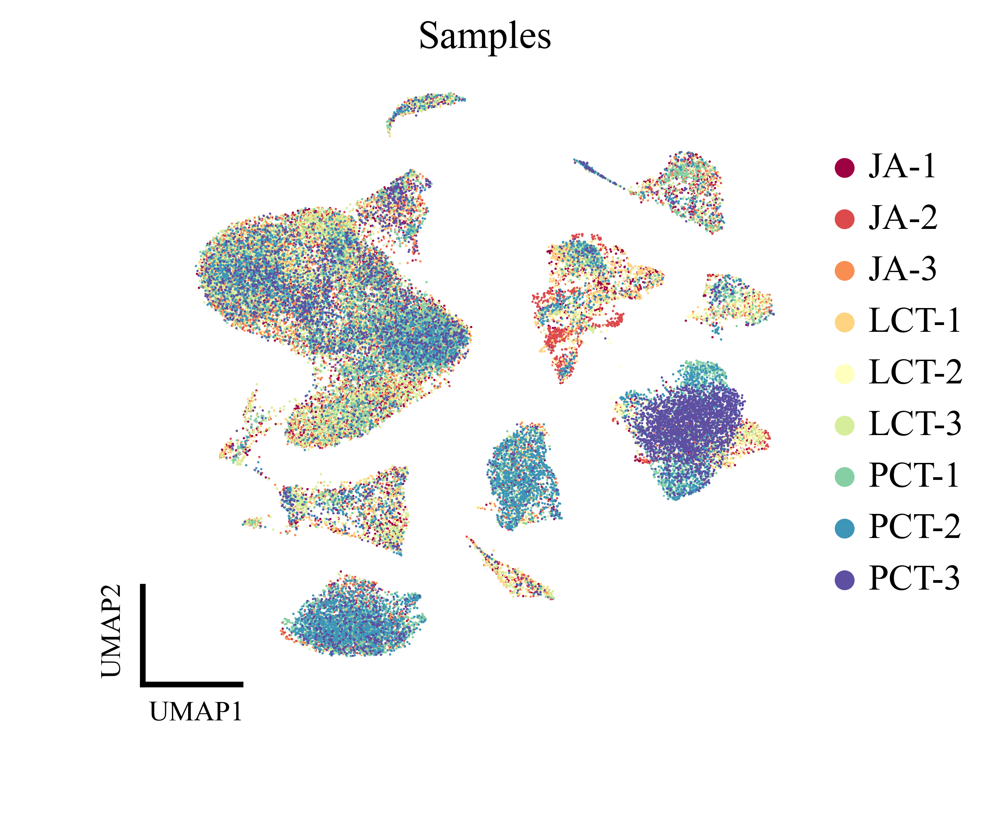

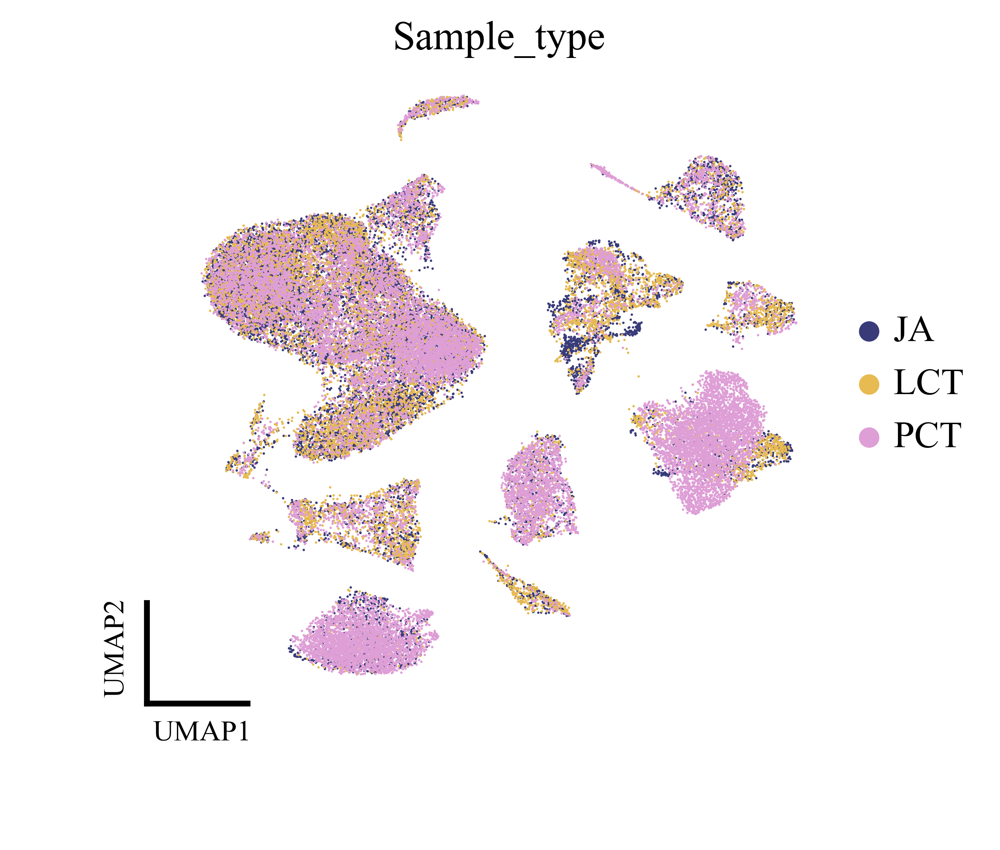

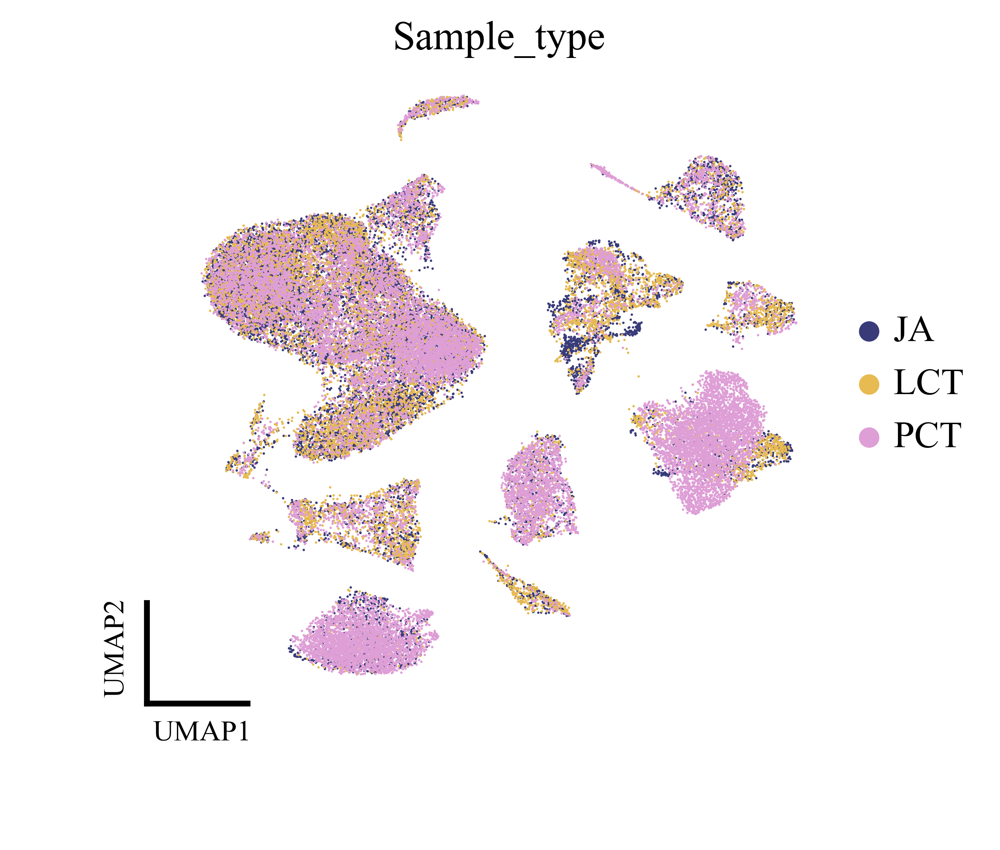

In [ ]:
ScPyPy.adv_umap(adata, color="Samples", palette='Spectral',min_ax_fontsize = 10,min_ax_lw = 2, save=None)
ScPyPy.adv_umap(adata, color="Sample_type", palette="tab20b",min_ax_fontsize = 10,min_ax_lw = 2, save=None)

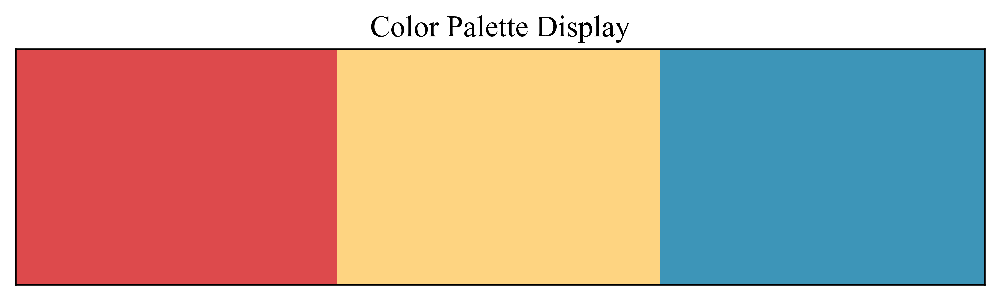

In [ ]:
import matplotlib.pyplot as plt
palette_id = ["#dd4a4c","#fed481",'#3d95b8']
plt.figure(figsize=(8, 2))
for i, color in enumerate(palette_id):
    plt.fill_between([i, i+1], 0, 1, color=color)
plt.xlim(0, len(palette_id))
plt.ylim(0, 1)
plt.xticks([])
plt.yticks([])
plt.title("Color Palette Display")
plt.show()

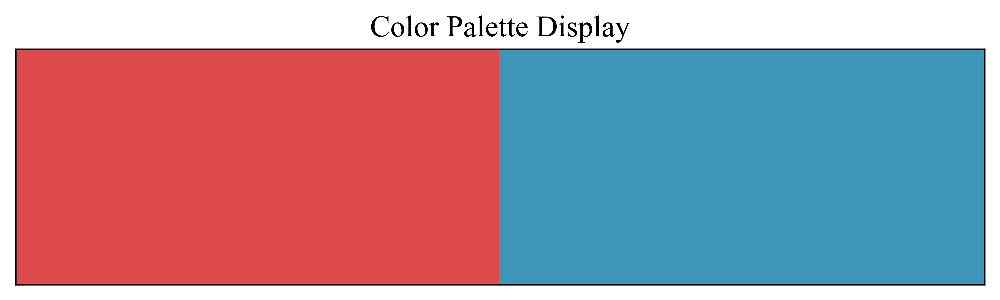

In [ ]:
import matplotlib.pyplot as plt
palette_smoke = ["#dd4a4c",'#3d95b8']
plt.figure(figsize=(8, 2))
for i, color in enumerate(palette_smoke):
    plt.fill_between([i, i+1], 0, 1, color=color)
plt.xlim(0, len(palette_smoke))
plt.ylim(0, 1)
plt.xticks([])
plt.yticks([])
plt.title("Color Palette Display")
plt.show()


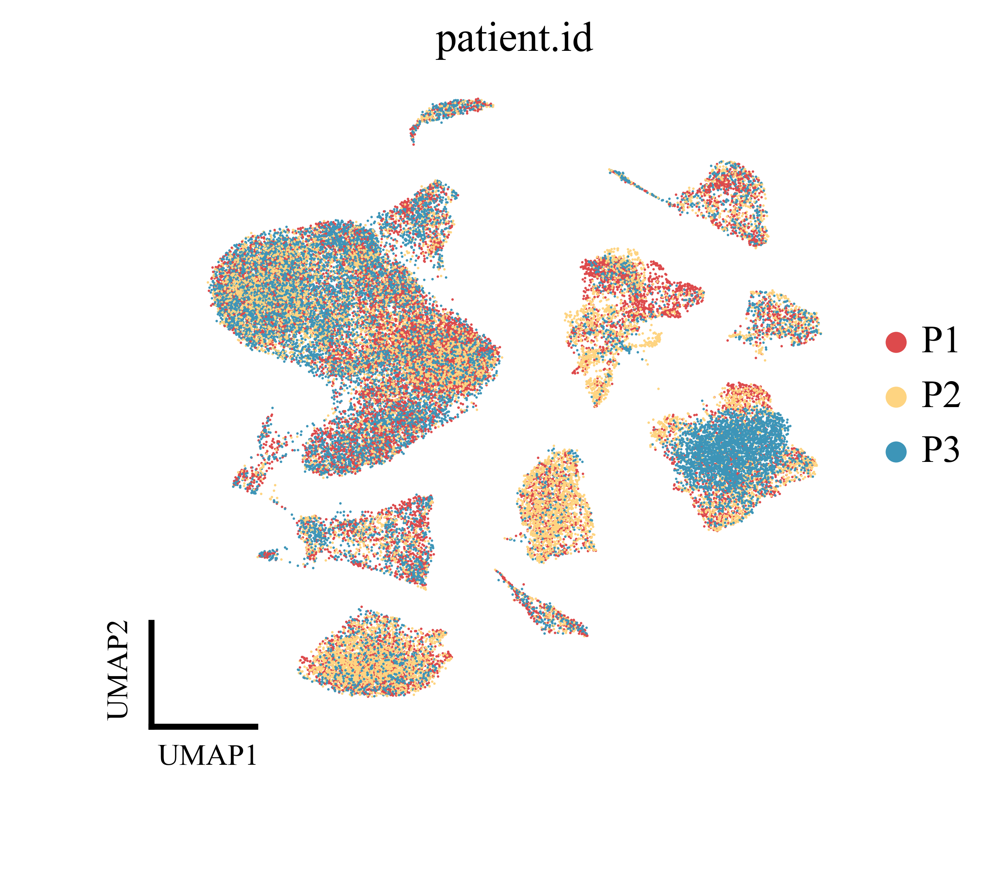

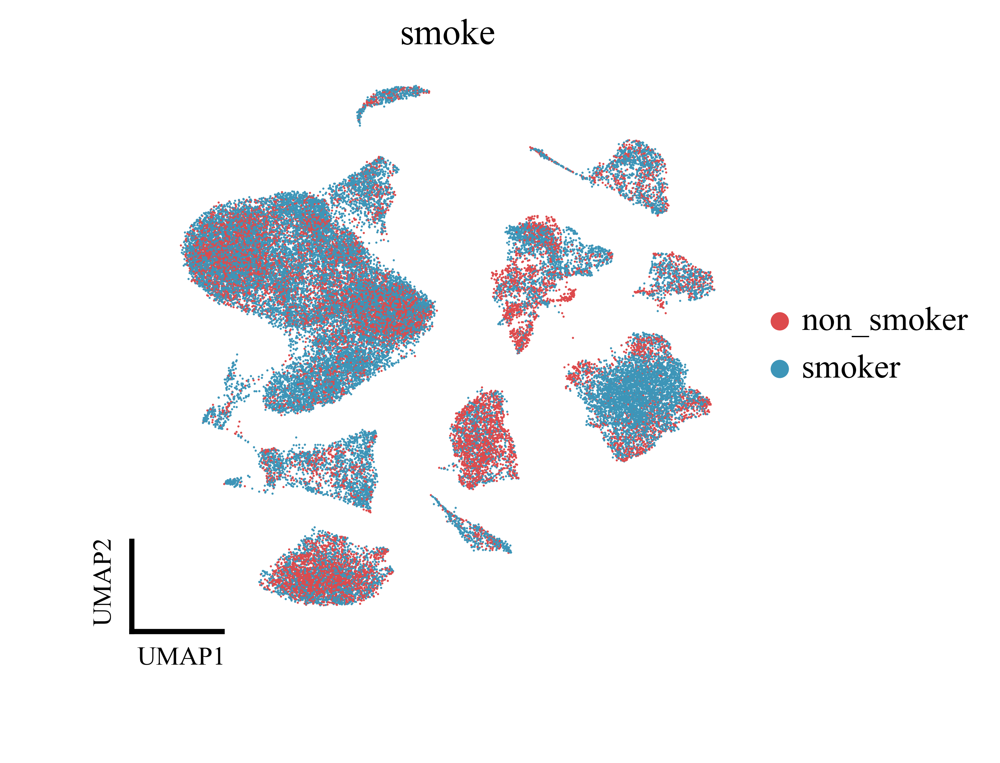

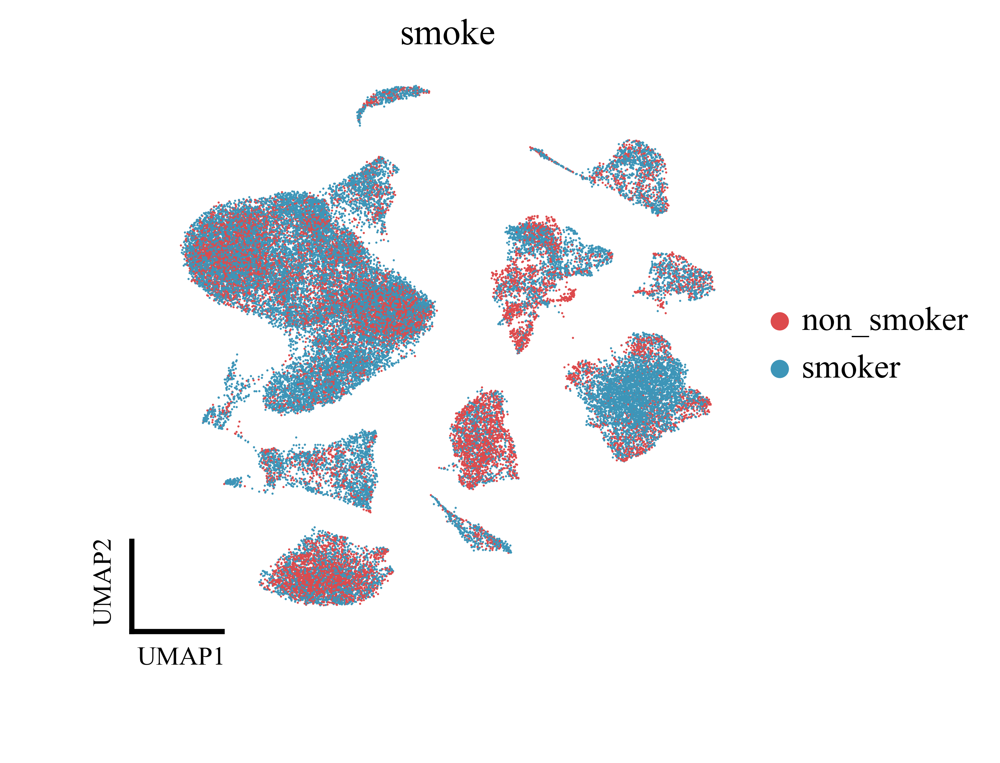

In [ ]:
ScPyPy.adv_umap(adata, color="patient.id", palette=palette_id,min_ax_fontsize = 10,min_ax_lw = 2, save=None)
ScPyPy.adv_umap(adata, color="smoke", palette=palette_smoke,min_ax_fontsize = 10,min_ax_lw = 2, save=None)

In [ ]:
adata.obs['Samples'].unique()

['JA-1', 'JA-2', 'JA-3', 'LCT-1', 'LCT-2', 'LCT-3', 'PCT-1', 'PCT-2', 'PCT-3']
Categories (9, object): ['JA-1', 'JA-2', 'JA-3', 'LCT-1', ..., 'LCT-3', 'PCT-1', 'PCT-2', 'PCT-3']

In [ ]:
desired_order =[
    "B cells", "Plasma cells",'NK cells', "CD4$^{+}$T", "CD8$^{+}$T", "Mast cells", "Neutrophils"  , "Myeloid cells",'DC',  "Epi" ,"Endo", "Fibro", 'Pericytes'   # Epithelial
]
adata.obs["major2"] = adata.obs["major2"].cat.reorder_categories(desired_order, ordered=True)
print(adata.obs["major2"].cat.categories)


Index(['B cells', 'Plasma cells', 'NK cells', 'CD4$^{+}$T', 'CD8$^{+}$T',
       'Mast cells', 'Neutrophils', 'Myeloid cells', 'DC', 'Epi', 'Endo',
       'Fibro', 'Pericytes'],
      dtype='object')


In [ ]:
adata.obs["major2"].cat.categories

Index(['B cells', 'Plasma cells', 'NK cells', 'CD4$^{+}$T', 'CD8$^{+}$T',
       'Mast cells', 'Neutrophils', 'Myeloid cells', 'DC', 'Epi', 'Endo',
       'Fibro', 'Pericytes'],
      dtype='object')

In [ ]:
adata.obs['Major_Type'] = adata.obs['major2']

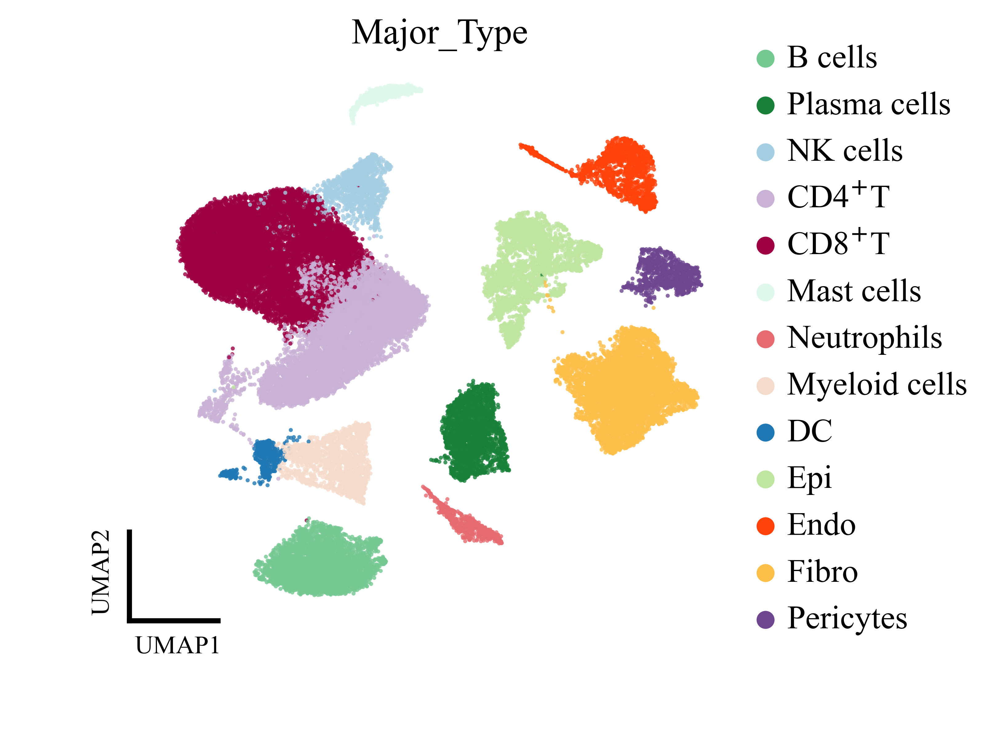

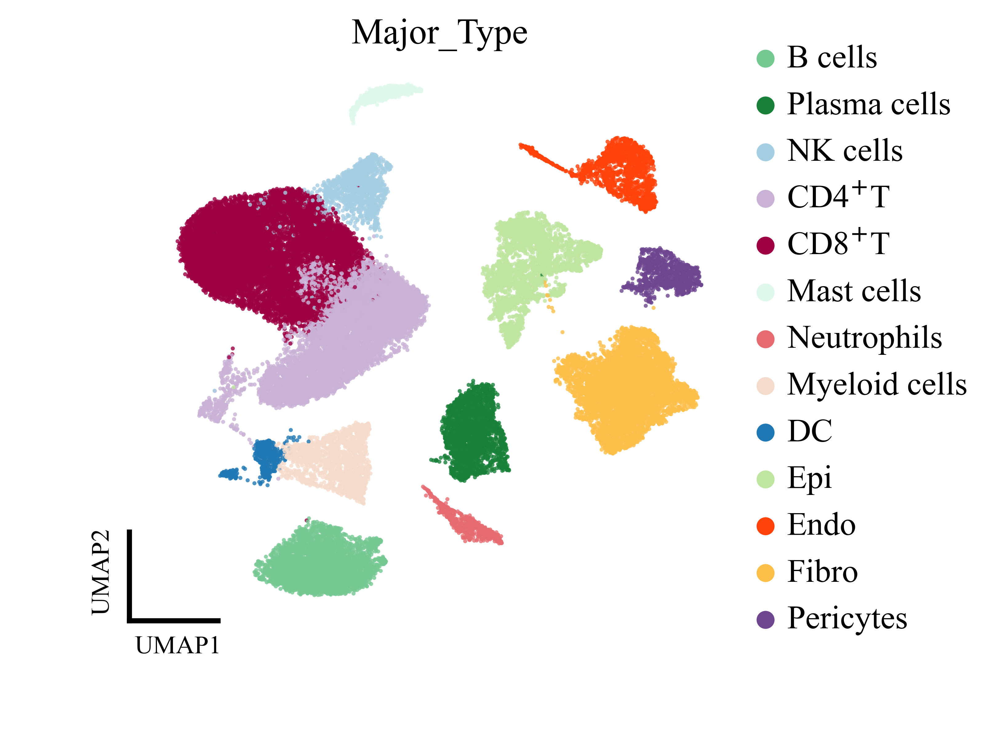

In [ ]:
import pandas as pd

custom_order = [
    "B cells", "Plasma cells",'NK cells', "CD4$^{+}$T", "CD8$^{+}$T", "Mast cells", "Neutrophils"  , "Myeloid cells",'DC',  "Epi" ,"Endo", "Fibro", 'Pericytes'   # Epithelial
]

adata.obs['Major_Type'] = pd.Categorical(
    adata.obs['Major_Type'],
    categories=custom_order,
    ordered=True
)

ScPyPy.adv_umap(adata, color="Major_Type",size = 10, alpha = 0.8, palette=palette_major, min_ax_fontsize=10, min_ax_lw=2, save=None)

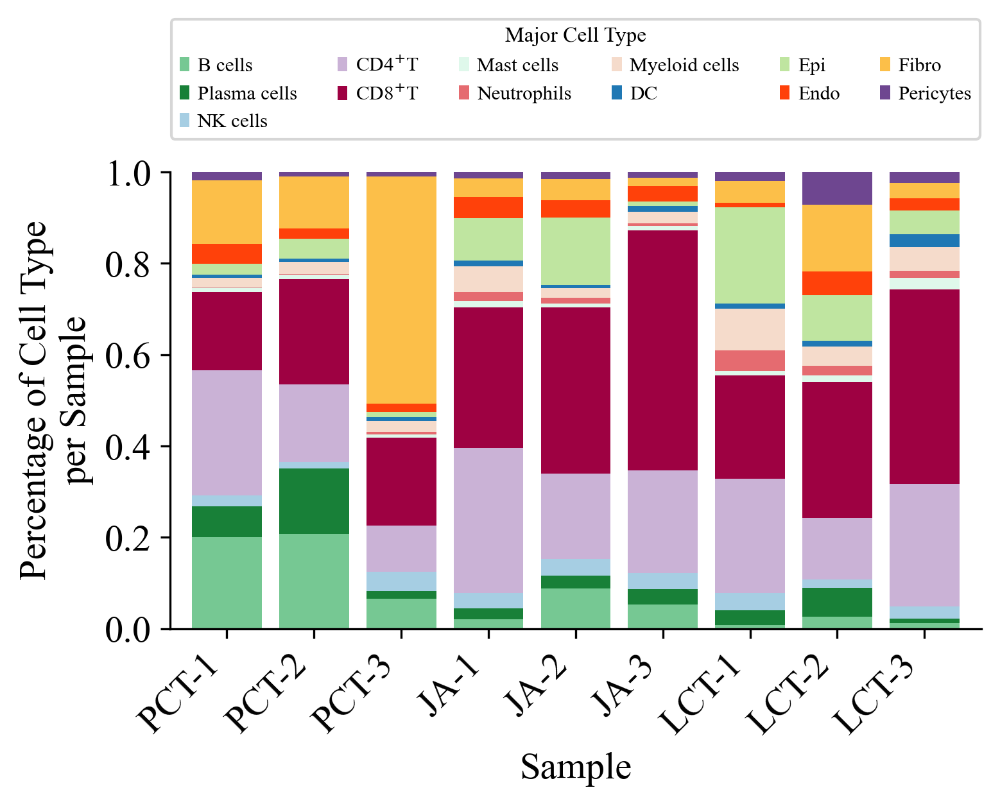

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.legend_handler import HandlerPatch  # 确保从这里导入 HandlerPatch


class HandlerCircle(HandlerPatch):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize, trans):
        center = 0.5 * width - 0.5 * xdescent, 0.5 * height - 0.5 * ydescent
        p = mpatches.Circle(xy=center, radius=height / 4)
        self.update_prop(p, orig_handle, legend)
        p.set_transform(trans)
        return [p]

custom_order = ['PCT-1', 'PCT-2', 'PCT-3', 'JA-1', 'JA-2', 'JA-3', 'LCT-1', 'LCT-2', 'LCT-3']
col_order = [
    "B cells", "Plasma cells",'NK cells', "CD4$^{+}$T", "CD8$^{+}$T", "Mast cells", "Neutrophils"  ,
    "Myeloid cells",'DC',  "Epi" ,"Endo", "Fibro", 'Pericytes'   # Epithelial
]

counts = adata.obs.groupby(['Samples', 'Major_Type']).size().unstack(fill_value=0)
counts = counts.reindex(custom_order)
counts = counts.reindex(columns=col_order, fill_value=0)

percentage = counts.div(counts.sum(axis=1), axis=0)

ax = percentage.plot(kind='bar', stacked=True, figsize=(5.4, 4.5), colormap=palettebar, width=0.8)
ax.set_ylabel("Percentage of Cell Type\nper Sample")
ax.set_xlabel("Sample")
ax.set_ylim(0, 1)

plt.xticks(rotation=45, ha="right")
plt.grid(False)

plt.legend(
    title='Major Cell Type',
    loc='lower center',
    bbox_to_anchor=(0.5, 1.05),
    ncol=6,    prop={'size': 7.5},
    title_fontsize='8',
    handler_map={mpatches.Rectangle: HandlerCircle()}
)

plt.tight_layout()
plt.show()

#function

In [ ]:
class ScPyPy:
    @staticmethod
    def adv_umap(adata, color=None, mask_obs=None, gene_symbols=None, use_raw=None, sort_order=True, edges=False,
        edges_width=0.1, edges_color='grey', neighbors_key=None, arrows=False, arrows_kwds=None, groups=None,
        components=None, dimensions=None, layer=None, projection='2d', scale_factor=None, color_map="plasma",
        cmap=None, palette='tab20b', na_color='lightgray', na_in_legend=True, size=None, frameon=False,
        legend_fontsize=None, legend_fontweight='bold', legend_loc='right margin', legend_fontoutline=None,
        colorbar_loc='right', vmax=None, vmin=None, vcenter=None, norm=None, add_outline=False,
        outline_width=(0.3, 0.05), outline_color=('black', 'white'), ncols=4, hspace=0.25, wspace=None, title=None,
        show=False, save=None, ax=None, return_fig=None, marker='.',min_ax_fontsize = 6,min_ax_lw = 2, **kwargs):
        """
        Visualize UMAP projections of the data with the option to save the output.

        Example:
        adv_umap(adata, color_feature, palette='tab20b', save=None, save_format='png')
        Parameters:
        adata (AnnData): Annotated data matrix.
        color_feature (str): Column name in adata.obs to use for coloring.
        palette (str, optional): Color palette name. Defaults to 'tab20b'.
        save (str, optional): If provided, save the figure to this file name within a 'figures' directory.
        save_format (str, optional): Format to save the figure in, e.g., 'png', 'pdf', etc. Defaults to 'png'.
        """
        fig, main_ax = plt.subplots()
        #sc.pl.umap(adata, color=[color_feature], frameon=False, ax=main_ax, show=False,color_map=color_map, palette=palette)
        sc.pl.umap(
        adata=adata,
        ax=main_ax,
        color=color,
        mask_obs=mask_obs,
        gene_symbols=gene_symbols,
        use_raw=use_raw,
        sort_order=sort_order,
        edges=edges,
        edges_width=edges_width,
        edges_color=edges_color,
        neighbors_key=neighbors_key,
        arrows=arrows,
        arrows_kwds=arrows_kwds,
        groups=groups,
        components=components,
        dimensions=dimensions,
        layer=layer,
        projection=projection,
        scale_factor=scale_factor,
        color_map=color_map,
        cmap=cmap,
        palette=palette,
        na_color=na_color,
        na_in_legend=na_in_legend,
        size=size,
        frameon=frameon,
        legend_fontsize=legend_fontsize,
        legend_fontweight=legend_fontweight,
        legend_loc=legend_loc,
        legend_fontoutline=legend_fontoutline,
        colorbar_loc=colorbar_loc,
        vmax=vmax,
        vmin=vmin,
        vcenter=vcenter,
        norm=norm,
        add_outline=add_outline,
        outline_width=outline_width,
        outline_color=outline_color,
        ncols=ncols,
        hspace=hspace,
        wspace=wspace,
        title=title,
        show=show,
        save=save,
        return_fig=return_fig,
        marker=marker,
        **kwargs
              )
        min_ax = fig.add_axes([0.0, 0.0, 0.6, 0.6])  # xmin, ymin, dx, dy
        min_ax.set_xlim(0, 2)
        min_ax.set_ylim(0, 2)
        min_ax.axis('off')
        min_ax.plot([0.5, 0.9], [0.5, 0.5], lw=min_ax_lw, color='k')
        min_ax.plot([0.5, 0.5], [0.5, 0.9], lw=min_ax_lw, color='k')
        min_ax.text(0.72, 0.38, 'UMAP1', horizontalalignment='center', verticalalignment='center', fontsize=min_ax_fontsize, fontweight='bold')
        min_ax.text(0.38, 0.72, 'UMAP2', horizontalalignment='center', verticalalignment='center', fontsize=min_ax_fontsize, rotation=90, fontweight='bold')

        if save:
            os.makedirs('figures', exist_ok=True)
            file_path = os.path.join('figures', f'{save}.{save_format}')
            plt.savefig(file_path, format=save_format, dpi=300)
            print(f"Saved figure as {file_path}")

        plt.show()
        #plt.close(fig)

        return fig
        plt.close(fig)
